In [1]:
import snapatac2 as snap
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import scanpy as sc
import os
import polars as pl

In [2]:
sns.set_theme(style="whitegrid", rc={"figure.figsize": (10, 8)})

In [3]:
# Utility functions

def close_adatas(adatas):
    for adata in adatas:
        adata.close()

# Import data
- snapATAC2 provides us a way to process each set of fragments in paralell
- We will import the fragments and perform feature definintion and QC on them
- We will then concatenate each sample into an anndata set object

In [4]:
data_directory = "./brain_data"

In [5]:
E18_file_names = ["E18_Hom_1", "E18_Hom_2", "E18_Con_1", "E18_Con_2"]
E14_file_names = ["E14_Hom_1", "E14_Hom_2", "E14_Con_1", "E14_Con_2"]
combined_file_names = [*E14_file_names, *E18_file_names]


In [6]:
adatas = [snap.read(f'{data_directory}/snATAC-seq/atac_brain_data_common_barcodes/anndatas/{file}.h5ad') for file in combined_file_names]

In [7]:
sum([anndata.shape[0] for anndata in adatas])

44505

# QC and Pre-processing
- Rnsure the fragment size distribution meets the expected distribution (3 different peaks)
    - The three peaks represent the presence of different types of transposase interactions
- Filter the cells that don't meet the minimum TSSE and are within the range of fragments
    - This allows us to only keep fragments that are likely to be biologically relevant and not the result of technical artefacts
- For understanding fragment size distribution and TSSE, refer to this article
    - https://genomebiology.biomedcentral.com/articles/10.1186/s13059-020-1929-3#:~:text=Typically%2C%20a%20successful%20ATAC%2Dseq,bp%2C%20respectively)%20(Fig.


In [33]:
# close_adatas(adatas)

In [11]:
snap.metrics.frag_size_distr(
    adatas,
)
snap.metrics.tsse(adatas, snap.genome.mm10)

100%|██████████| 8/8 [00:11<00:00,  1.39s/it]
100%|█████████████████████████████████████| 24.0M/24.0M [00:00<00:00, 49.6GB/s]
100%|██████████| 8/8 [00:18<00:00,  2.28s/it]


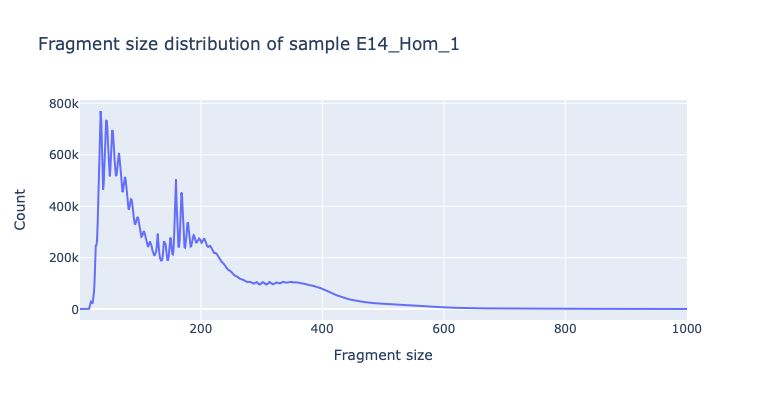

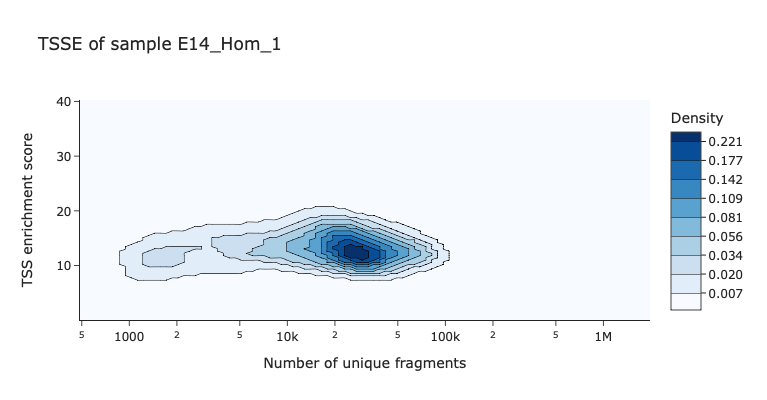

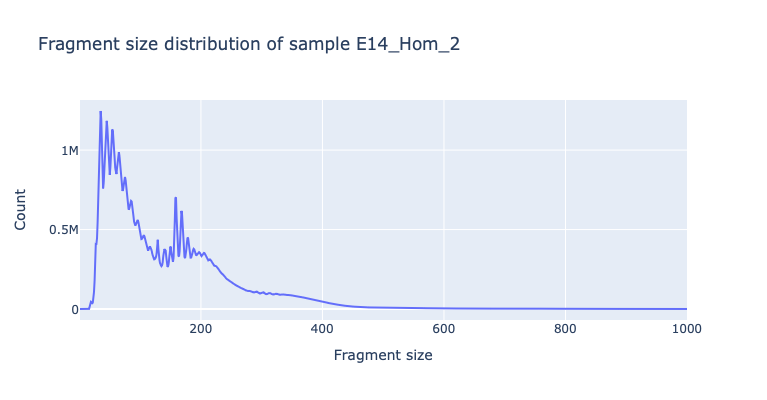

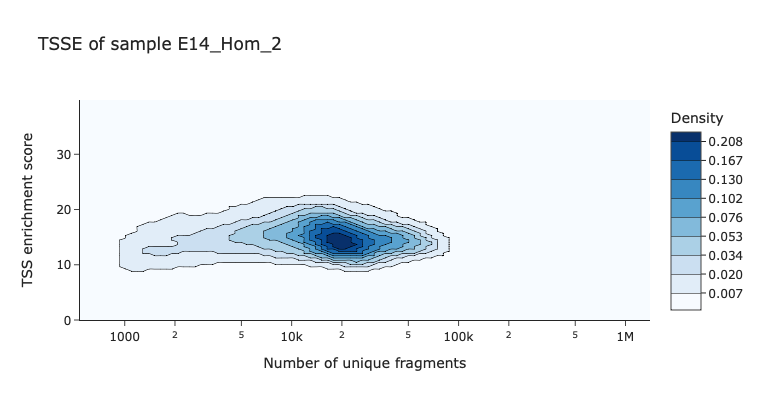

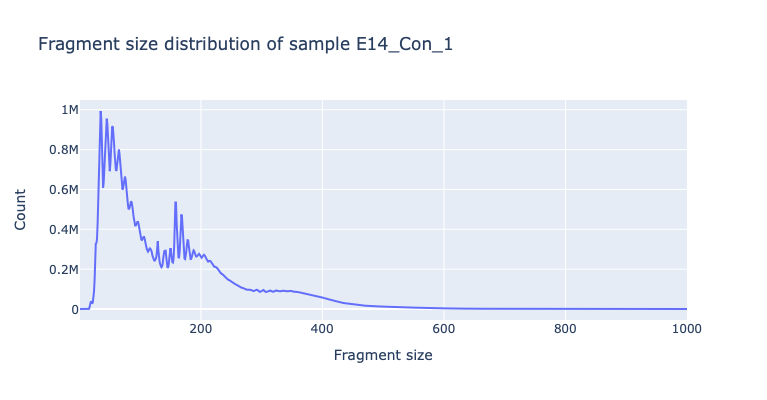

...

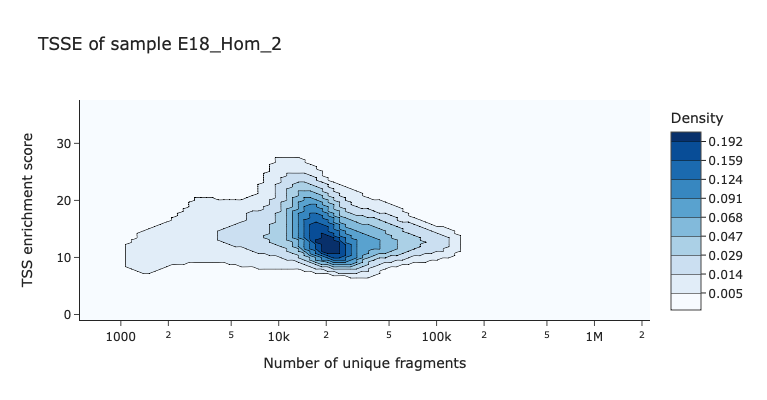

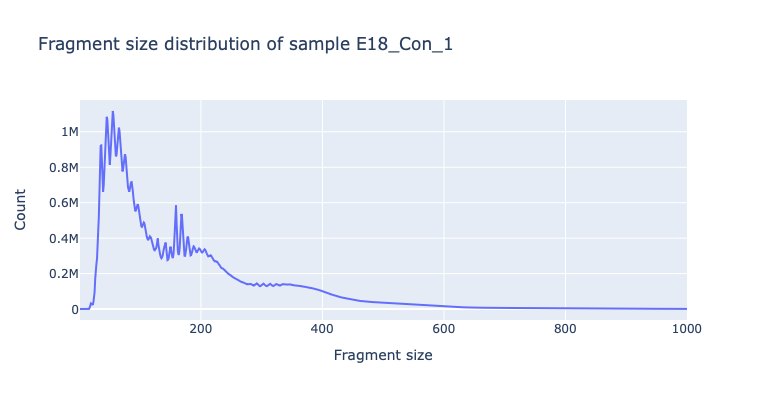

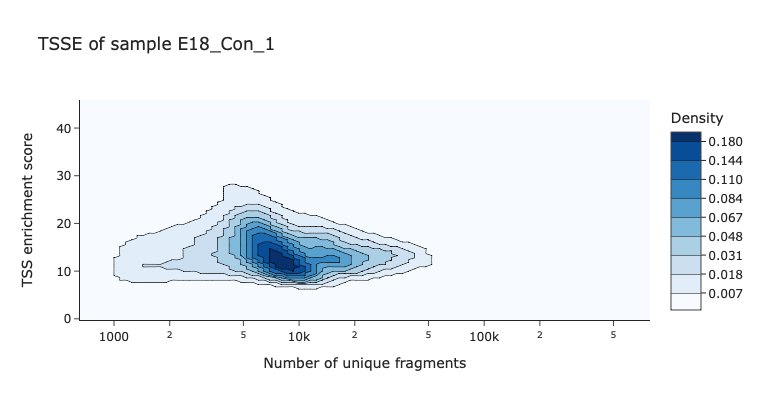

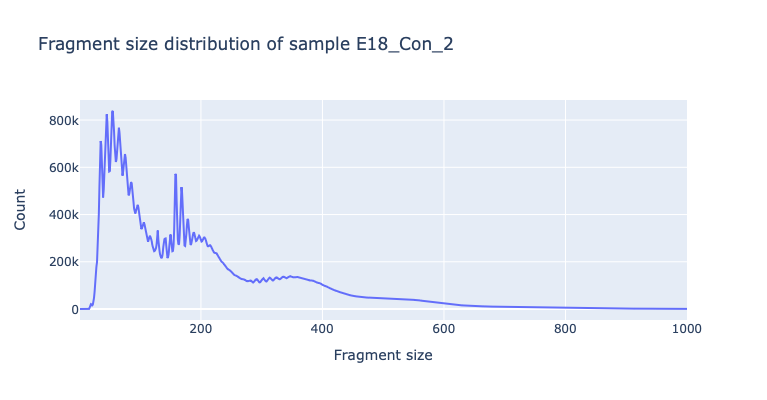

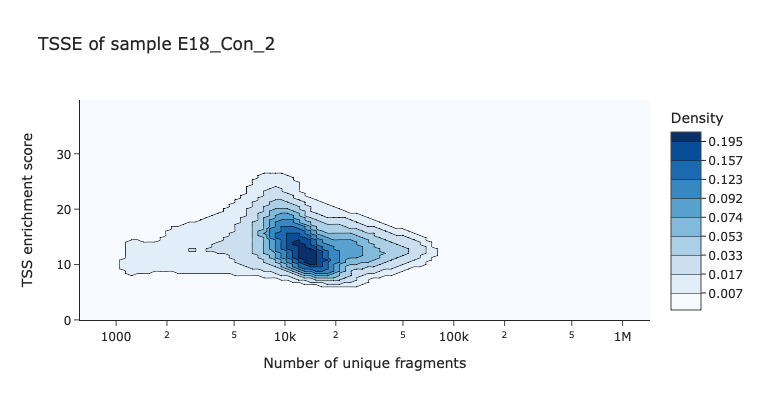

In [9]:
for adata, sample in zip(adatas, combined_file_names):
    frag_fig = snap.pl.frag_size_distr(adata,show=False)
    frag_fig.update_layout(title=f"Fragment size distribution of sample {sample}")
    #frag_fig.update_yaxes(type="log")
    frag_fig.show()
    
    tsse_fig = snap.pl.tsse(adata,show=False)
    tsse_fig.update_layout(title=f"TSSE of sample {sample}")
    tsse_fig.show()

Lets filter cells based on the TSSE visualisations. We are only interested in cells where the density of TSSE and fragment counts are high.

In [10]:
# Filter cells according to the frag size distr and TSSE visualisations for each sample
E14_adatas = adatas[:4]
E18_adatas = adatas[4:]

# E14 - The min and max counts needed seem to be consistent across samples in E14
for adata in E14_adatas:
    snap.pp.filter_cells(
        adata, min_tsse=7, max_tsse=23, min_counts=5000, max_counts=100000, n_jobs=98
    )


# The min and max counts needed in E18 don't seem to be as consistent, so need to filter cells individually

# E18_Hom_1

snap.pp.filter_cells(
    E18_adatas[0], min_tsse=7, max_tsse=23, min_counts=5000, max_counts=70000, n_jobs=98
)

# E18_Hom_2
snap.pp.filter_cells(
    E18_adatas[2], min_tsse=7, max_tsse=23, min_counts=5000, max_counts=78000, n_jobs=98
)


# E18_Con_1
snap.pp.filter_cells(
    E18_adatas[2], min_tsse=7, max_tsse=23, min_counts=3000, max_counts=35000, n_jobs=98
)

# E18_Con_2
snap.pp.filter_cells(
    E18_adatas[3], min_tsse=7, max_tsse=23, min_counts=5000, max_counts=54000, n_jobs=98
)

# Define features
- You'll find that some papers refer to snapATAC V1, though this is fine as some aspects of snapATAC2 still utilise the same approach as V1
- We want to perform genomic binning of 500bp regions
    - This isn't too large such that we don't average out signal from regions that are biologically relevant and also not too small such that the time  of processing the data ins't ridiculously slow
    - We're potentially dealing with hundreds of thousands or millions of features here, so its practical that we want to reduce the number of features to work with
    - Articles that refer to using binning
        - https://www.nature.com/articles/s41576-023-00586-w
        - https://www.nature.com/articles/s41588-021-00790-6
              - go to section "ArchR provides high-resolution and efficient dimensionality reduction of scATAC-seq data", it discusses some ideas behind choosing an optimal bin size
        - https://www.ncbi.nlm.nih.gov/pmc/articles/PMC9590475/
- We want to use fragment or  paired-insertion counting strategy given these two papers. Paired-insertion seems to be more stringent and capture relevant fragment reads at genomic regions
    - https://www.nature.com/articles/s41592-023-02103-7
    - https://www.biorxiv.org/content/10.1101/2022.05.04.490536v3.full.pdf

In [12]:
snap.pp.add_tile_matrix(adatas, bin_size=500, counting_strategy='paired-insertion', n_jobs=98)

100%|██████████| 8/8 [00:36<00:00,  4.55s/it]


In [6]:
adatas

NameError: name 'adatas' is not defined

# Convert list of anndatas to AnnDataSet
- According to SnapATAC2's multi-sample workflow reccomendations, if we want to perform downstream analysis on the data as a whole, it needs to be in the form of an AnnDataSet object
- Therefore we need to close each individual adata file and reopen the data using the "_dataset.h5ads" AnnDataSet created from the "resolve_barcodes.ipynb"
- This contains references to each h5ad file representing each sample

In [9]:
data = snap.AnnDataSet(
    adatas=[(name, adata) for name, adata in zip(combined_file_names, adatas)],
    filename=f"{data_directory}/snATAC-seq/atac_data_common_post_qc_barcodes.h5ads"
)

In [10]:
data

AnnDataSet object with n_obs x n_vars = 44505 x 5267565 backed at './brain_data/snATAC-seq/atac_data_common_post_qc_barcodes.h5ads'
contains 8 AnnData objects with keys: 'E14_Hom_1', 'E14_Hom_2', 'E14_Con_1', 'E14_Con_2', 'E18_Hom_1', 'E18_Hom_2', 'E18_Con_1', 'E18_Con_2'
    obs: 'sample'
    uns: 'AnnDataSet', 'reference_sequences'

# Remove E18_Con_1 and intersect with barcodes from post-QC snRNA-seq data
- E18_Con_1 seems to look fine here, but since the cell was of low quality in the snRNA-seq data, we shall remove it

In [11]:
data_adata = data.to_adata(copy_x=True)
data_adata

AnnData object with n_obs × n_vars = 44505 × 5267565
    obs: 'sample'
    uns: 'AnnDataSet', 'reference_sequences'

In [12]:
# Create a mask to only keep cells which are not in E18_Con_1
data_adata_filtered = data_adata.obs_names.isin(data_adata[data_adata.obs['sample'] != "E18_Con_1"].obs_names)
rna_data = sc.read_h5ad(f"{data_directory}/snRNA-seq/rna_brain_data_post_qc.h5ad")
rna_data_clustered = sc.read_h5ad(f"{data_directory}/snRNA-seq/clustered_gex.h5ad")

common_obs = data_adata.obs_names.intersection(rna_data.obs['atac_barcode'])

data_adata_common_barcodes = data_adata.obs_names.isin(common_obs)
data_adata_combined_filtered_barcodes = data_adata_filtered & data_adata_common_barcodes
rna_data_common_clustered = rna_data_clustered[rna_data_clustered.obs['atac_barcode'].isin(common_obs)].copy()

In [13]:
# UNCOMMENT IF YOU NEED TO SUBSET THE DATA
data = data.subset(obs_indices=data_adata_combined_filtered_barcodes, out=f"{data_directory}/snATAC-seq/atac_brain_common_post_qc_barcodes")[0]

In [14]:
cell_to_leiden = dict(zip(rna_data_common_clustered.obs['atac_barcode'], rna_data_common_clustered.obs['leiden']))
data.obs['leiden'] = pd.Series(data.obs_names).map(cell_to_leiden)

In [15]:
data.obs['age'] = [index.split('_')[0] for index in data.obs_names]

In [16]:
data.obs['genotype'] = [index.split('_')[1] for index in data.obs_names]

In [24]:
# Define a dictionary to map cell types to leiden clusters
cluster_cell_type_dict_combined = {
    '0': 'Neurons - immature',
    '1': 'Radial glial cells',
    '2': 'Neurons',
    '3': 'Radial glial cells',
    '4': 'Interneurons',
    '5': 'Neurons',
    '6': 'Neurons',
    '7': 'Interneurons',
    '8': 'Neurons - immature',
    '9': 'Neurons',
    '10': 'Intermediate progenitor cells',
    '11': 'Neurons',
    '12': 'Neurons',
    '13': 'Interneurons',
    '14': 'Neurons',
    '15': 'Astrocytes',
    '16': 'Neurons',
    '17': 'Pericytes',
    '18': 'Interneurons',
    '19': 'Cajal-Retzius cells',
    '20': 'Neurons',
    '21': 'Endothelial cells',
    '22': 'Microglia',
    '23': 'Oligodendrocytes',
}


data.obs['cell_type'] = pd.Series(data.obs['leiden']).map(cluster_cell_type_dict_combined)

In [27]:
# Close to ensure the data is saved
data.close() 

In [41]:
data = snap.read_dataset(f"{data_directory}/snATAC-seq/atac_brain_common_post_qc_barcodes/_dataset.h5ads")

In [42]:
data

AnnDataSet object with n_obs x n_vars = 32833 x 5267565 backed at './brain_data/snATAC-seq/atac_brain_common_post_qc_barcodes/_dataset.h5ads'
contains 8 AnnData objects with keys: 'E14_Hom_1', 'E14_Hom_2', 'E14_Con_1', 'E14_Con_2', 'E18_Hom_1', 'E18_Hom_2', 'E18_Con_1', 'E18_Con_2'
    obs: 'sample', 'leiden', 'age', 'genotype', 'cell_type'
    var: 'count', 'selected'
    uns: 'spectral_eigenvalue', 'reference_sequences', 'num_eigen', 'AnnDataSet'
    obsm: 'X_umap', 'X_spectral'

# Feature selection
- We need to optimize the number of features chosen in order for each eigen value to be the highest it can be after the first component
- We can also specify iterations to the select_features function for it to iteratively refine the features chosen
    - It does so by choosing the top N features ranked according to their variance within leiden clusters formed at a resolution of 1.0
    - I'm not sure if this actually does anything significant but its worth experimenting with...
- As a rule of thumb, large datasets with more complex structures will benefit from larger Ns, while small datasets with fewer cell types or less prominent cluster structures should go with smaller Ns.
- Blacklist paper: https://www.nature.com/articles/s41598-019-45839-z
- ArchR Paper where iterative feature selection was inspired from: https://www.nature.com/articles/s41588-021-00790-6#Sec11
- The github discussion of the author of SnapATAC2 discussion iterative feature selection: https://github.com/kaizhang/SnapATAC2/discussions/116


## Experimentation
- Results
     - Make sure to use blacklisted regions
    - Utilising the raw data here results in low eigenvalues for components after the first one. Therefore we'll need to utilise an iterative approach suggested by ArchR.
      - The downside of this approach is that it relies on leiden clustering using an arbitrary resolution of 1.0. This isn't a biologically informed parameter and therefore it could propogate clustering error and noise for feature selection.
      - Therefore we will use an adjusted feature selection function that takes advantage of the clusters identified in the snRNA-seq workflow

2024-03-27 23:00:34 - INFO - Selected 25000 features.


Spectral eigenvalues using 25000 features


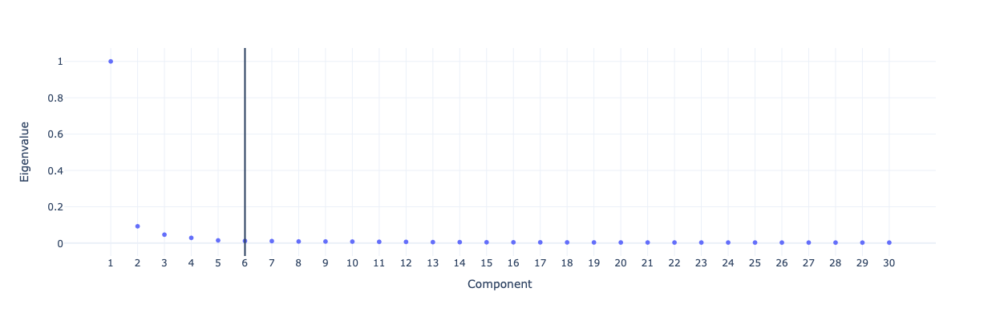

2024-03-27 23:09:13 - INFO - Selected 27500 features.


Spectral eigenvalues using 27500 features


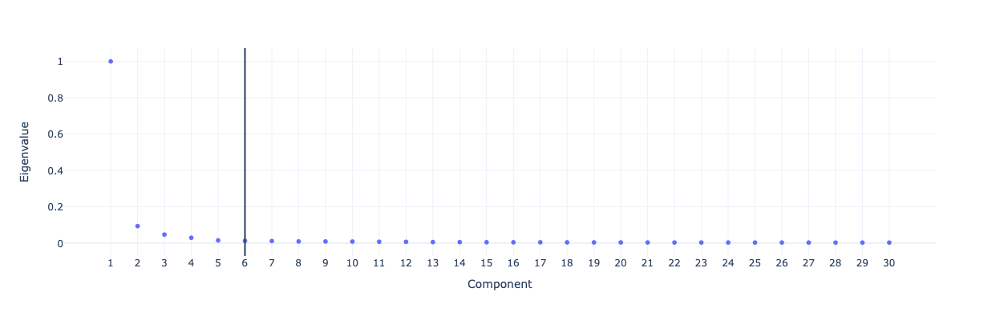

2024-03-27 23:18:11 - INFO - Selected 30000 features.


Spectral eigenvalues using 30000 features


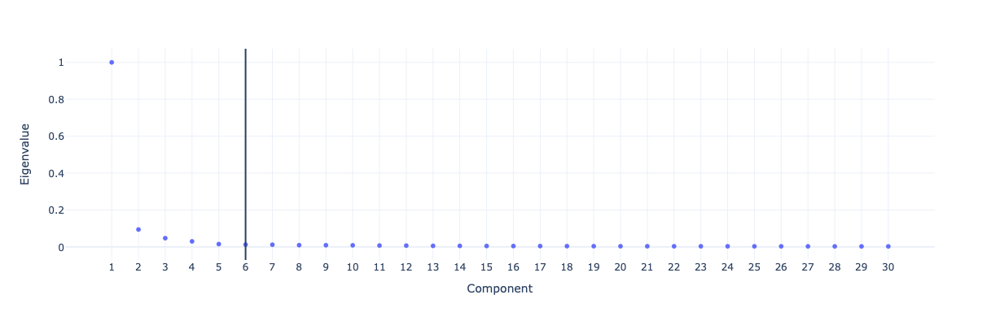

2024-03-27 23:26:54 - INFO - Selected 32500 features.


Spectral eigenvalues using 32500 features


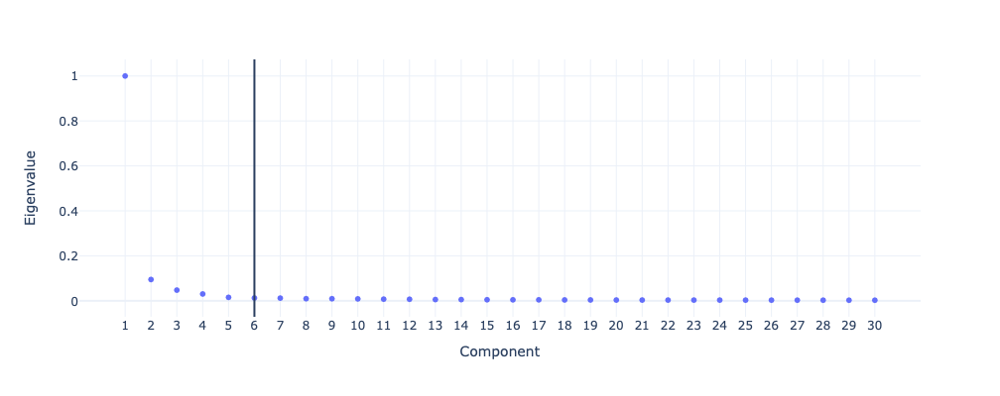

2024-03-27 23:35:18 - INFO - Selected 35000 features.


Spectral eigenvalues using 35000 features


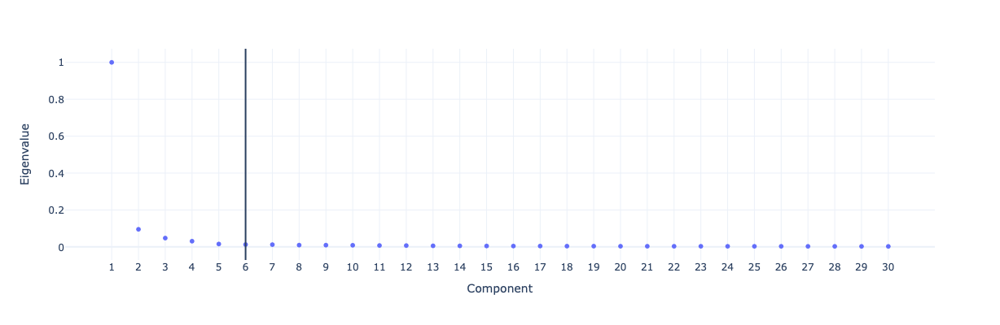

2024-03-27 23:44:15 - INFO - Selected 37500 features.


Spectral eigenvalues using 37500 features


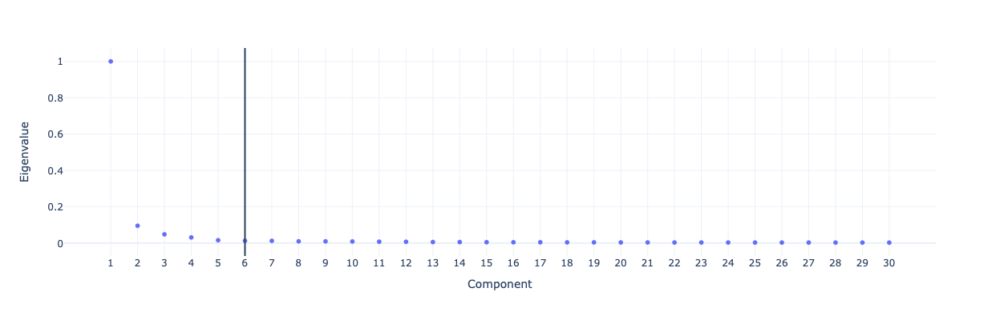

2024-03-27 23:53:50 - INFO - Selected 40000 features.


KeyboardInterrupt: 

In [15]:
# Experiment with different features chosen# Initialize a list to hold the DataFrames
# df_list = []
for i in range(25000,50000, 2500):
    snap.pp.select_features(data, n_features=i, n_jobs=16)
    snap.tl.spectral(data)
    print(f"Spectral eigenvalues using {i} features")
    snap.pl.spectral_eigenvalues(data)

2024-03-28 01:40:32 - INFO - Selected 25000 features.


Spectral eigenvalues using 25000 features


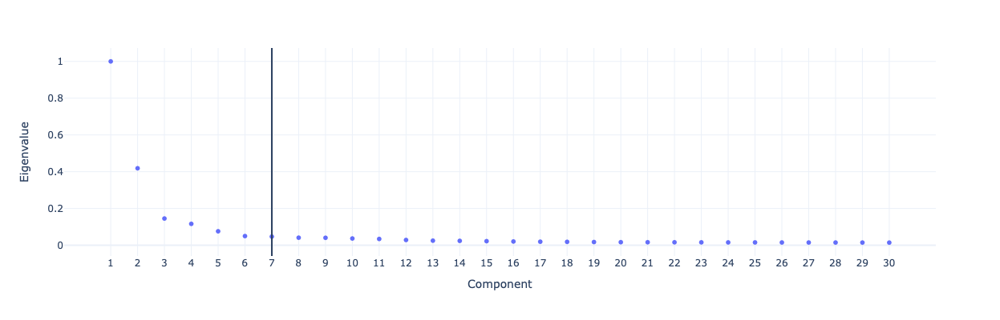

2024-03-28 03:29:18 - INFO - Selected 27500 features.


Spectral eigenvalues using 27500 features


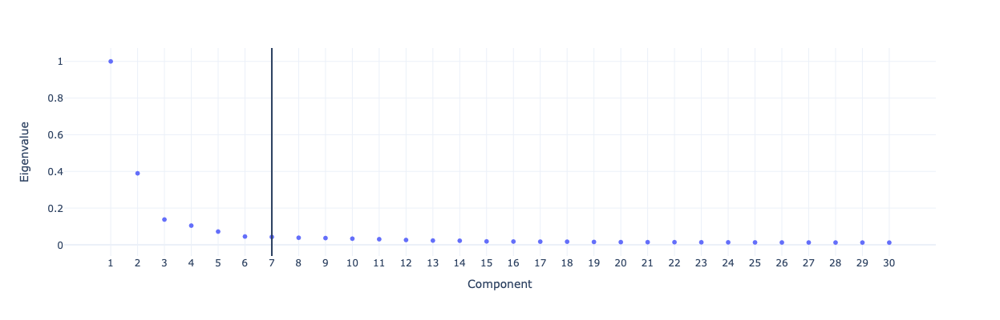

2024-03-28 05:18:03 - INFO - Selected 30000 features.


Spectral eigenvalues using 30000 features


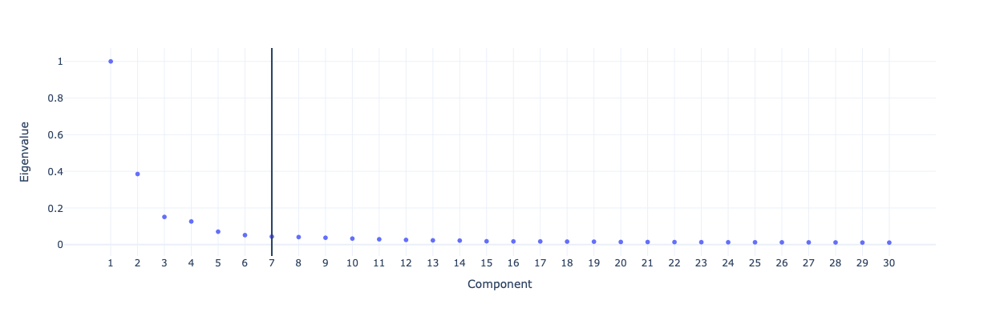

2024-03-28 07:08:17 - INFO - Selected 32500 features.


Spectral eigenvalues using 32500 features


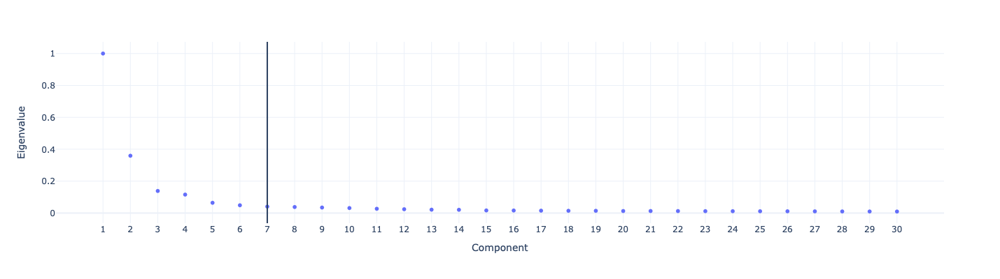

KeyboardInterrupt: 

In [16]:
# Experiment with different features chosen using iterative refinement of those features
for i in range(25000,50000, 2500):
    snap.pp.select_features(data, n_features=i, max_iter=5, n_jobs=16)
    snap.tl.spectral(data)
    print(f"Spectral eigenvalues using {i} features")
    snap.pl.spectral_eigenvalues(data)

2024-03-28 10:45:08 - INFO - Selected 24746 features.


Spectral eigenvalues using 25000 features


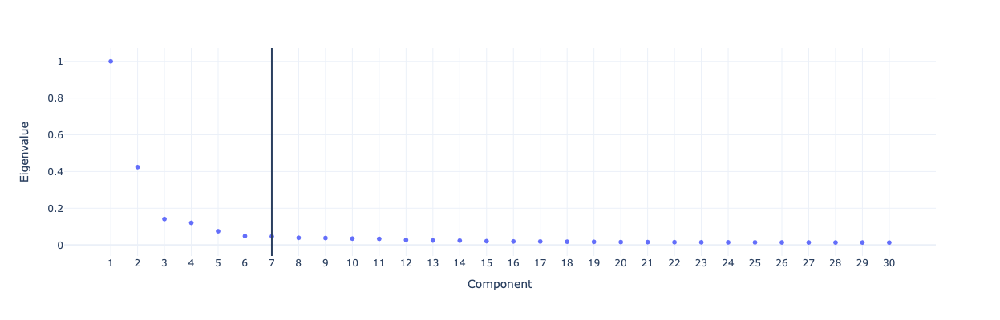

2024-03-28 12:33:38 - INFO - Selected 27248 features.


Spectral eigenvalues using 27500 features


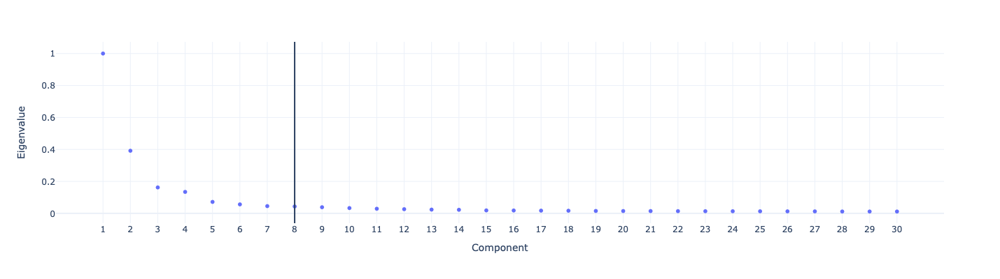

2024-03-28 14:23:03 - INFO - Selected 29666 features.


Spectral eigenvalues using 30000 features


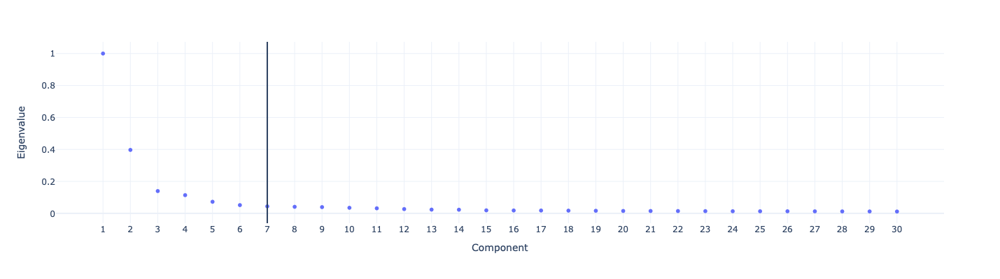

In [ ]:
# Experiment with feature selection, but include blacklist to remove regions that introduce technical artefacts
for i in range(25000,50000, 2500):
    snap.pp.select_features(data, n_features=i,max_iter=5, blacklist=f"/media/WorkingSpace/harry/brain_data/snATAC-seq/mm10-blacklist.v2.bed.gz")
    snap.tl.spectral(data)
    print(f"Spectral eigenvalues using {i} features")
    snap.pl.spectral_eigenvalues(data)

## Chosen implementation

In [30]:
from pathlib import Path
import snapatac2._snapatac2 as internal
import logging

def _find_most_accessible_features(
    feature_count,
    filter_lower_quantile,
    filter_upper_quantile,
    total_features,
) -> np.ndarray:
    idx = np.argsort(feature_count)
    for i in range(idx.size):
        if feature_count[idx[i]] > 0:
            break
    idx = idx[i:]
    n = idx.size
    n_lower = int(filter_lower_quantile * n)
    n_upper = int(filter_upper_quantile * n)
    idx = idx[n_lower:n-n_upper]
    return idx[::-1][:total_features]

# Custom feature selection method
# The only thing that I've changed is to use the clustering key, instead of the leiden clusters
def select_features(
    adata,
    clustering_key: str,
    n_features: int = 500000,
    filter_lower_quantile: float = 0.005,
    filter_upper_quantile: float = 0.005,
    whitelist: Path | None = None,
    blacklist: Path | None = None,
    max_iter: int = 1,
    inplace: bool = True,
    n_jobs: int = 8,
    verbose: bool = True,
) -> np.ndarray | list[np.ndarray] | None:
    if isinstance(adata, list):
        result = snap._utils.anndata_par(
            adata,
            lambda x: select_features(x, n_features, filter_lower_quantile,
                                      filter_upper_quantile, whitelist,
                                      blacklist, max_iter, inplace, verbose=False),
            n_jobs=n_jobs,
        )
        if inplace:
            return None
        else:
            return result

    count = np.zeros(adata.shape[1])
    for batch, _, _ in adata.chunked_X(2000):
        count += np.ravel(batch.sum(axis = 0))
    adata.var['count'] = count

    selected_features = _find_most_accessible_features(
        count, filter_lower_quantile, filter_upper_quantile, n_features)

    if blacklist is not None:
        blacklist = np.array(internal.intersect_bed(adata.var_names, str(blacklist)))
        selected_features = selected_features[np.logical_not(blacklist[selected_features])]

    # Iteratively select features
    iter = 1
    while iter < max_iter:
        embedding = snap.tl.spectral(adata, features=selected_features, inplace=False)[1]
        rpm = snap.tl.aggregate_X(adata, groupby=clustering_key).X
        var = np.var(np.log(rpm + 1), axis=0)
        selected_features = np.argsort(var)[::-1][:n_features]

        # Apply blacklist to the result
        if blacklist is not None:
            selected_features = selected_features[np.logical_not(blacklist[selected_features])]
        iter += 1

    result = np.zeros(adata.shape[1], dtype=bool)
    result[selected_features] = True

    # Finally, apply whitelist to the result
    if whitelist is not None:
        whitelist = np.array(internal.intersect_bed(adata.var_names, str(whitelist)))
        whitelist &= count != 0
        result |= whitelist
    
    if verbose:
        logging.info(f"Selected {result.sum()} features.")

    if inplace:
        adata.var["selected"] = result
    else:
        return result

In [31]:
# NOTE: This is a custom function to use the cell type clusters identified in the snRNA-seq workflow
select_features(
    data, 
    clustering_key='cell_type', 
    max_iter=5, 
    blacklist=f"{data_directory}/snATAC-seq/mm10-blacklist.v2.bed.gz", 
    n_features=25000,
    n_jobs=180
)

2024-04-29 10:36:59 - INFO - Selected 24855 features.


# Dimensionality Reuction and UMAP

In [32]:
snap.tl.spectral(data)

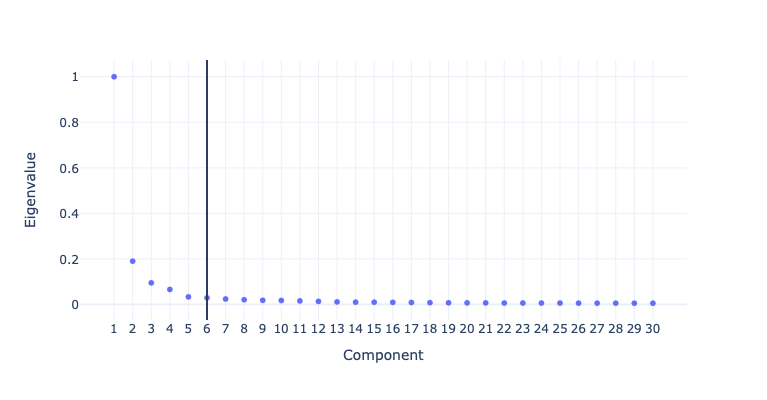

In [33]:
snap.pl.spectral_eigenvalues(data)

In [34]:
snap.tl.umap(data)

/home/s4785038/.conda/envs/thesis/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html

/home/s4785038/.conda/envs/thesis/lib/python3.12/site-packages/umap/umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



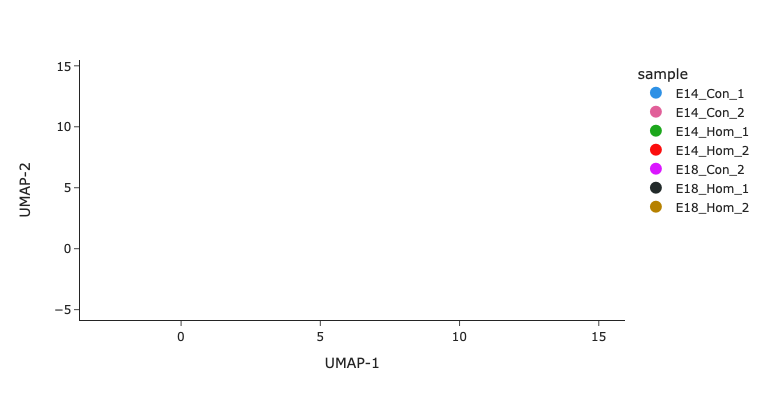

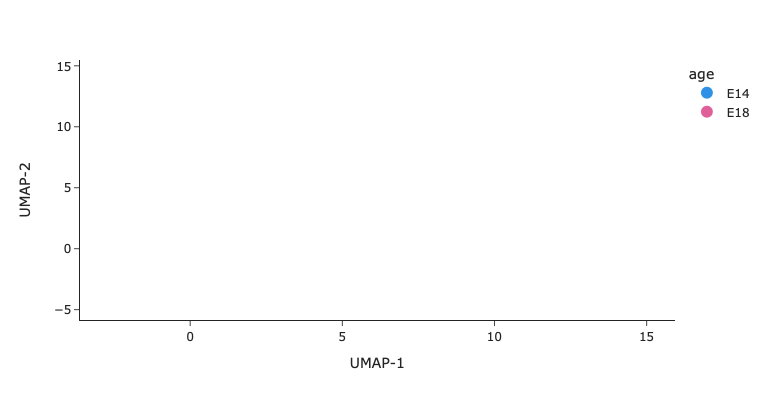

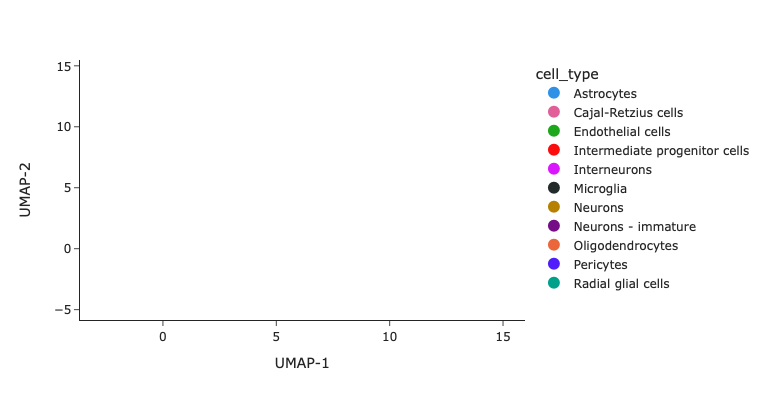

In [35]:
snap.pl.umap(data, color="sample", interactive=True)
snap.pl.umap(data, color="age", interactive=True)
snap.pl.umap(data, color="cell_type", interactive=True)

In [ ]:
data.close()
data = snap.read_dataset(f"{data_directory}/snATAC-seq/atac_brain_common_post_qc_barcodes/_dataset.h5ads")

# Identify differentially accessible regions
- Understanding what peak calling is important here
    - https://genomebiology.biomedcentral.com/articles/10.1186/s13059-020-1929-3#Sec18
    - https://www.nature.com/articles/s41576-023-00586-w

In [ ]:
peaks = {"cell_type" : None}
peak_mats = {"cell_type" : None}
marker_peaks = {"cell_type":None}
motifs = {"cell_type":None}

In [73]:
def diff_accessability(group):
    snap.tl.macs3(
        data,
        groupby=group,
        replicate='sample',
        key_added=f"macs3_{group}",
        blacklist=f"{data_directory}/snATAC-seq/mm10-blacklist.v2.bed.gz",
        n_jobs=180
    )
    
    peaks[group] = snap.tl.merge_peaks(data.uns[f'macs3_{group}'], snap.genome.mm10)
    print(peaks[group].head())
    peak_mats[group] = snap.pp.make_peak_matrix(
        data,
        use_rep=peaks[group]['Peaks'],
        counting_strategy='paired-insertion'
    )
    
    marker_peaks[group] = snap.tl.marker_regions(peak_mats[group], groupby=group, pvalue=0.01)
    snap.pl.regions(
        peak_mats[group], 
        groupby=group, 
        peaks=marker_peaks[group], 
        interactive=False
    )
    
    motifs = snap.tl.motif_enrichment(
        motifs=snap.datasets.cis_bp(unique=True),
        regions=marker_peaks[group],
        genome_fasta=snap.genome.mm10,
    )
    snap.pl.motif_enrichment(motifs, max_fdr=0.000001, height=1600, interactive=False)

In [44]:
diff_accessability("cell_type")

2024-04-29 10:54:52 - INFO - Exporting fragments...
2024-04-29 10:59:04 - INFO - Calling peaks...
100%|██████████| 11/11 [1:14:36<00:00, 406.99s/it]
/home/s4785038/.conda/envs/thesis/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning:

Transforming to str index.

2024-04-29 12:14:49 - INFO - Fetching 6356 sequences ...
2024-04-29 12:15:15 - INFO - Computing enrichment ...
100%|██████████| 1165/1165 [00:47<00:00, 24.56it/s]


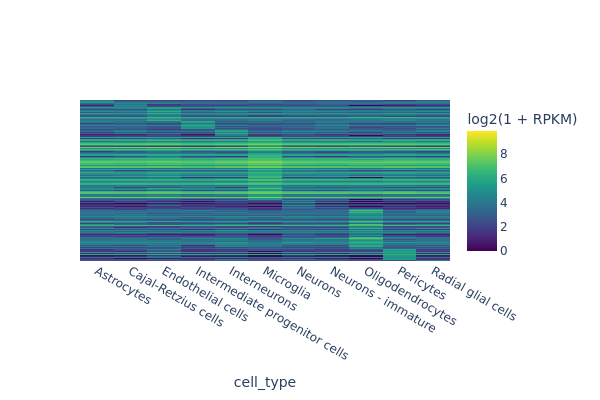

In [60]:
 snap.pl.regions(
        peak_mats["cell_type"], 
        groupby="cell_type", 
        peaks=marker_peaks["cell_type"], 
        interactive=False
    )

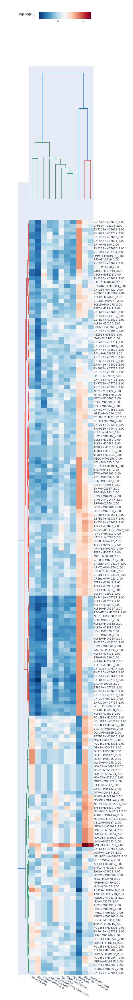

In [77]:
# motifs = snap.tl.motif_enrichment(
#         motifs=snap.datasets.cis_bp(unique=True),
#         regions=marker_peaks["cell_type"],
#         genome_fasta=snap.genome.mm10,
#     )
snap.pl.motif_enrichment(motifs, max_fdr=0.000001, height=4500, interactive=False)

## Peak calling

In [33]:
snap.tl.macs3(data, groupby=groupby, replicate='sample', blacklist=f"{data_directory}/snATAC-seq/mm10-blacklist.v2.bed.gz",n_jobs=149)

2024-04-27 22:23:51 - INFO - Exporting fragments...
2024-04-27 22:26:56 - INFO - Calling peaks...
100%|██████████| 24/24 [22:01<00:00, 55.05s/it]


In [36]:
peaks = snap.tl.merge_peaks(data.uns['macs3'], snap.genome.mm10)
peaks.head()

Peaks,6,1,14,18,23,12,16,22,4,0,5,20,9,17,21,7,19,11,10,8,15,2,13,3
str,bool,bool,bool,bool,bool,bool,bool,bool,bool,bool,bool,bool,bool,bool,bool,bool,bool,bool,bool,bool,bool,bool,bool,bool
"""chr1:3093924-3…",false,false,false,false,false,false,false,false,false,false,false,false,false,false,false,false,false,false,true,true,false,false,false,false
"""chr1:3094771-3…",false,false,false,false,false,false,false,false,false,false,false,false,true,false,false,true,false,false,true,true,false,false,true,false
"""chr1:3406043-3…",false,false,false,false,false,false,false,false,false,false,false,false,false,false,false,true,false,false,false,false,false,false,false,false
"""chr1:3671526-3…",false,false,false,true,false,true,false,false,true,true,false,false,true,true,false,true,true,true,true,true,false,false,true,true
"""chr1:3670824-3…",false,false,false,true,false,true,false,false,true,true,false,false,true,true,false,true,true,true,true,true,false,false,true,true


In [38]:
peak_mat = snap.pp.make_peak_matrix(data, use_rep=peaks['Peaks'], counting_strategy='paired-insertion')

/home/s4785038/.conda/envs/thesis/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning:

Transforming to str index.



## Find marker regions

### Across all cells

In [39]:
marker_peaks = snap.tl.marker_regions(peak_mat, groupby=groupby, pvalue=0.01)

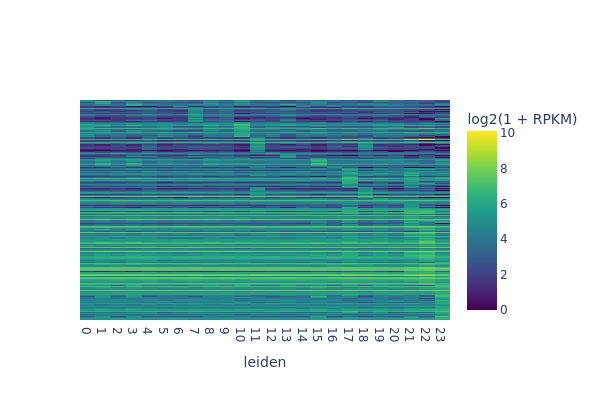

In [40]:
snap.pl.regions(peak_mat, groupby=groupby, peaks=marker_peaks, interactive=False)

In [ ]:
motifs = snap.tl.motif_enrichment(
    motifs=snap.datasets.cis_bp(unique=True),
    regions=marker_peaks,
    genome_fasta=snap.genome.mm10,
)

In [ ]:
snap.pl.motif_enrichment(motifs, max_fdr=0.0001, height=1600, interactive=False)

## Variations across cells (IN PROGRESS)
- To fully utilize the single-cell information, we can apply regression-based differential test method to find differentially accessible regions for specific cells
- Designing a robust background control is crucial for differential analysis.

In [ ]:
groups = np.unique(data.obs['cell_type'])



# Construct the background for each cell type that is left out for analysis
barcodes = np.array(data.obs_names)
background = []
for i in groups:
    if i != group2:
        cells = np.random.choice(barcodes[data.obs['cell_type'] == i], size=30, replace=False)
        background.append(cells)
background = np.concatenate(background)